<a href="https://colab.research.google.com/github/cesarbrea/hello_world/blob/master/CB_Image_Analyzer.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
# CB Image Analyzer
# This notebook uses a Gemini model to examine an image and tell us what it's about
# To run it, you upload a target image into the Colab notebook's /content/Image_Process_Experiment folder
# Then you edit the image filename references in the code to tell the notebook which file to pick
# First the notebook produces a simple caption
# Then the notebook suggests a number of image attributes, along with how sure it is in applying those attributes to the image
# Then it displays the attributes and their scores as a chart
# The point of this is to show how Gen AI can help to automatically tag marketing campaign assets
# With richer tags, we can do a better job of deciding how closely assets match themes suggested by creative briefs
# And, we can do a build better machine models to help decide which consumer should see what image...
# By asking, "How likely is a consumer with attributes A,B,C to interact with an ad with attributes D,E,F"

In [3]:
!pip install google-generativeai
import google.generativeai as genai
import os
from IPython import display
from PIL import Image
from google.colab import userdata
api_key = userdata.get('CB_Gemini_API_Key')

<class 'PIL.JpegImagePlugin.JpegImageFile'>
(4032, 3024)


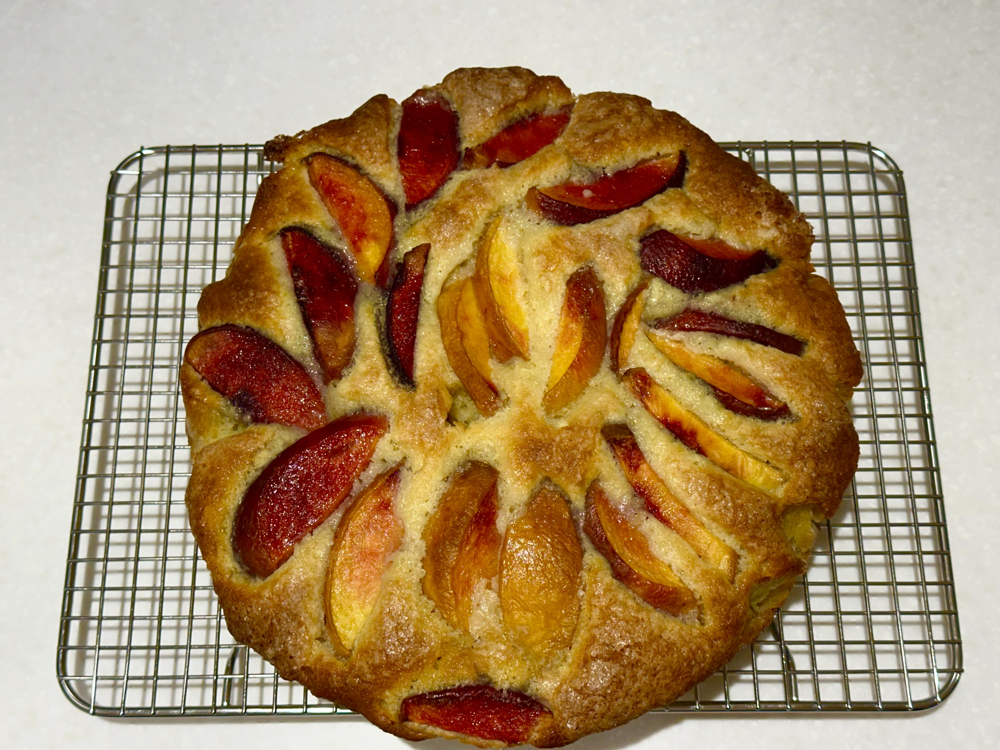

In [39]:
img_1 = Image.open("/content/Image_Process_Experiment/IMG_5227.jpg")


print(type(img_1))
print(img_1.size)
img_1

In [40]:
# First, to check that the Gen AI model is working, show it the image and ask it to generate a caption

image_path = "/content/Image_Process_Experiment/IMG_5227.jpg"

model = genai.GenerativeModel('gemini-2.0-flash')

if os.path.exists(image_path):
  myfile = genai.upload_file(path=image_path)
  response = model.generate_content(
      contents=[myfile, "Caption this image."]
  )

  print(response.text)

A plum cake sits on a metal wire rack.


In [41]:
# Now make the prompt more specific, asking for the top fifty elements, the associated certainty scores, and outputting a data frame with this content

elements_response = model.generate_content(
    contents=[myfile, "You are a software engineer. Please examine this image. Determine the most significant elements present in it. For example, elements can include objects (such as a man, tree, or car), conditions (such as sunny, rainy, empty, or crowded), emotions (such as somber, or joyous), or styles (such as realistic, or abstract). Summarize each element you identify in four words or less. Then, calculate the confidence you have in the accuracy with which you have identified that element, where 100% is certain, and 0% is completely uncertain. Then produce a dataframe that lists each of the elements you have identified. The first column of this dataframe is called \"Property\" and contains each element found, and the second column is called \"Confidence\" and contains the accuracy confidence for each element, expressed as a percentage. Please identify only the top fifty most certain elements. Finally, define the DataFrame as a variable called df"]
    )
print(elements_response.text)

Here's the breakdown of elements in the image and the resulting DataFrame:

```python
import pandas as pd

data = {'Property': ['Plum and nectarine galette',
                    'Cooling rack',
                    'Fruit tart',
                    'Baked dessert',
                    'Golden crust',
                    'Cut fruit',
                    'Stone fruit',
                    'Home baked',
                    'Eye level shot',
                    'Table top',
                    'Good lighting',
                    'Delicious looking',
                    'Simple design',
                    'Pastry',
                    'Sweet',
                    'Warm color',
                    'Metal rack',
                    'Clean background',
                    'Overhead view',
                    'Rustic',
                    'Fresh',
                    'Savory',
                    'Sweet aroma',
                    'Artistic',
                    'Golden-brown'],
        'Confi

In [42]:
# Create dataframe as first step toward plotting data

import re
from IPython.display import display

# Extract the Python code block that creates the DataFrame from the response text.
# This pattern looks for a code block that starts with ```python and ends with ```,
# capturing everything in between.
code_block_match = re.search(r'```python\n(.*?)\n```', elements_response.text, re.DOTALL)

if code_block_match:
    code_to_execute = code_block_match.group(1)
    # Execute the extracted code. This code should define the 'df' variable.
    exec(code_to_execute)
    print("DataFrame created by executing code block from response:")
    # Display the DataFrame
    display(df)
else:
    print("No Python code block found in the response.")
    # Initialize an empty DataFrame or handle this case as appropriate
    df = pd.DataFrame()

# The rest of your code should remain the same
# print("DataFrame created using pd.DataFrame.from_records():")
# print(df) # Commenting out this line as display(df) is used above

                      Property  Confidence
0   Plum and nectarine galette          99
1                 Cooling rack          99
2                   Fruit tart          98
3                Baked dessert          97
4                 Golden crust          96
5                    Cut fruit          95
6                  Stone fruit          94
7                   Home baked          94
8               Eye level shot          93
9                    Table top          92
10               Good lighting          91
11           Delicious looking          90
12               Simple design          89
13                      Pastry          88
14                       Sweet          87
15                  Warm color          86
16                  Metal rack          85
17            Clean background          84
18               Overhead view          83
19                      Rustic          82
20                       Fresh          81
21                      Savory          80
22         

,Property,Confidence
0,Plum and nectarine galette,99
1,Cooling rack,99
2,Fruit tart,98
3,Baked dessert,97
4,Golden crust,96
5,Cut fruit,95
6,Stone fruit,94
7,Home baked,94
8,Eye level shot,93
9,Table top,92


from matplotlib import pyplot as plt
df['Confidence'].plot(kind='hist', bins=20, title='Confidence')
plt.gca().spines[['top', 'right',]].set_visible(False)

from matplotlib import pyplot as plt
df['Confidence'].plot(kind='line', figsize=(8, 4), title='Confidence')
plt.gca().spines[['top', 'right']].set_visible(False)

In [31]:
# --- Make a copy of the DataFrame to ensure the original remains unchanged ---
df_for_plotting = df.copy()

# --- Display the DataFrame to confirm it's accessible ---
print("DataFrame available for plotting:")
print(df_for_plotting)

DataFrame available for plotting:
                 Property  Confidence
0            Plum Galette          99
1               Wire Rack          98
2             Baked Crust          97
3            Fruit Slices          96
4            Golden Brown          95
5             Round Shape          95
6           Overhead Shot          94
7          Pastry Dessert          93
8            Cooked Fruit          92
9             Shiny Glaze          92
10          White Surface          91
11             Warm Tones          90
12          Homemade Look          90
13          Simple Design          89
14           Grid Pattern          88
15       Food Photography          87
16            Sweet Treat          87
17       Neat Arrangement          86
18          Uniform Color          85
19          Crisp Texture          85
20          Natural Light          84
21          Close-Up View          83
22           Rustic Style          82
23        Kitchen Setting          82
24   Centered Co

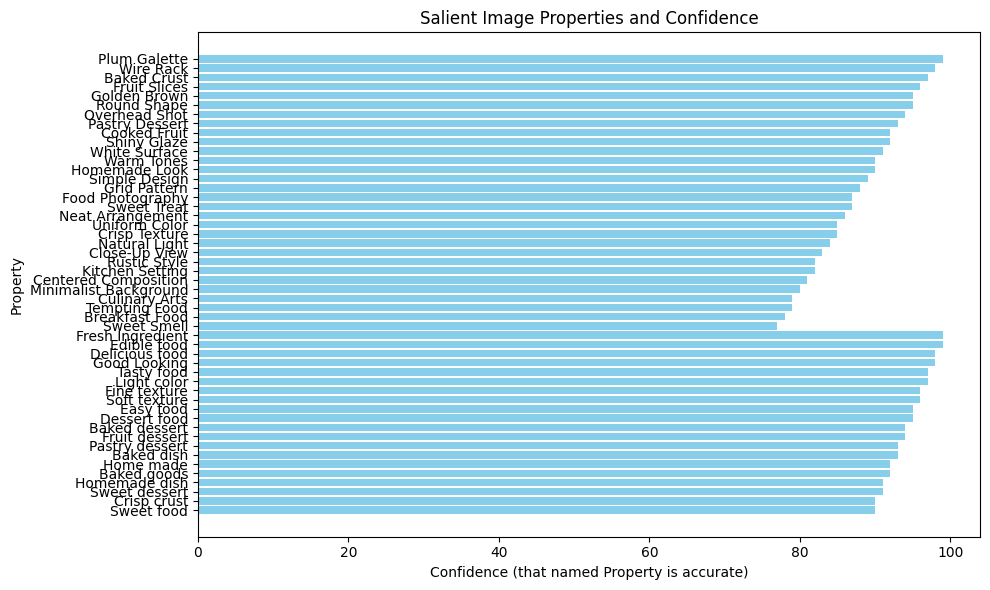

In [32]:
# --- Create a visual plot

# Import stuff I need

import matplotlib.pyplot as plt
import io

# --- Create the horizontal bar chart ---
plt.figure(figsize=(10, 6))
plt.barh(df_for_plotting['Property'], df_for_plotting['Confidence'], color='skyblue')
plt.xlabel('Confidence (that named Property is accurate)')
plt.ylabel('Property')
plt.title('Salient Image Properties and Confidence')
plt.gca().invert_yaxis()  # To display the first item at the top
plt.tight_layout()